# TP1 Chargement d’une vidéo avec OpenCV et Segmentation spatiale/temporelle
## Hela Khaddar - Bajar Imen

In [5]:
import cv2
import os
video = cv2.VideoCapture("Video.mp4")

In [6]:
if not video.isOpened():
    print("Impossible d'ouvrir la vidéo.")
else:
    # Obtenir la hauteur, la largeur et le nombre total de frames de la vidéo
    height = int(video.get(cv2.CAP_PROP_FRAME_HEIGHT))
    width = int(video.get(cv2.CAP_PROP_FRAME_WIDTH))
    frame_count = int(video.get(cv2.CAP_PROP_FRAME_COUNT))

    # Obtenir le FPS (frame per second) de la vidéo
    fps = int(video.get(cv2.CAP_PROP_FPS))
    
    print("Hauteur de la vidéo :", height)
    print("Largeur de la vidéo :", width)
    print("Nombre total de frames de la vidéo :", frame_count)
    print("FPS (frame per second) de la vidéo :", fps)

video.release()

Hauteur de la vidéo : 3840
Largeur de la vidéo : 2160
Nombre total de frames de la vidéo : 281
FPS (frame per second) de la vidéo : 59


### Extraction des frames de la vidéo et les sauvegarder

In [13]:
# Vérifier si la vidéo a pu être ouverte
video = cv2.VideoCapture("Video.mp4")
if not video.isOpened():
    print("Impossible d'ouvrir la vidéo.")
    
else:
    # Créer un dossier pour sauvegarder les frames s'il n'existe pas déjà
    if not os.path.exists("frames"):
        os.mkdir("frames")
        
    frame_number = 0 
    while True:
        ret, frame = video.read()  
        if not ret:
            break  

        # Sauvegarder la frame avec un numéro dans le dossier de travail
        frame_filename = os.path.join("frames", f"frame_{frame_number:04d}.jpg")
        cv2.imwrite(frame_filename, frame)

        frame_number += 1

video.release()

### Affichage des frames

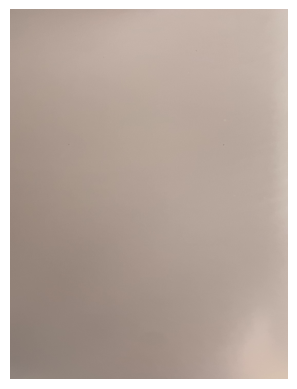

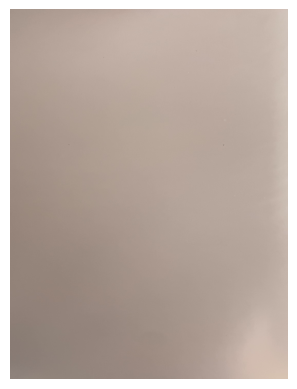

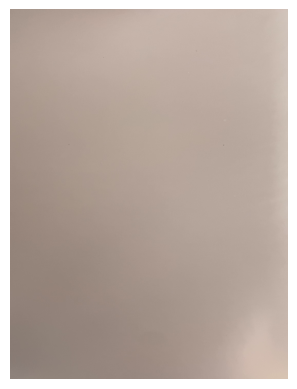

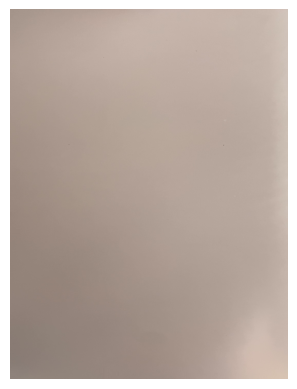

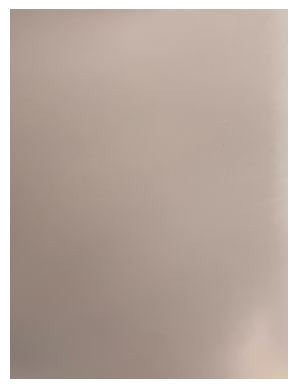

...

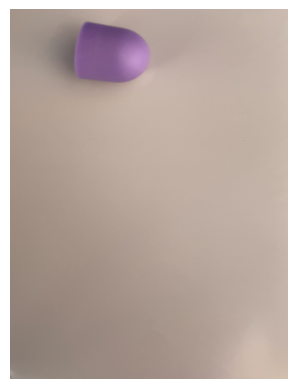

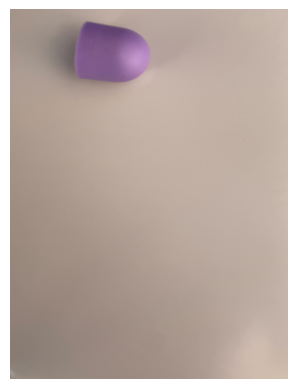

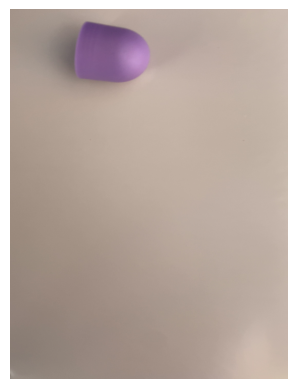

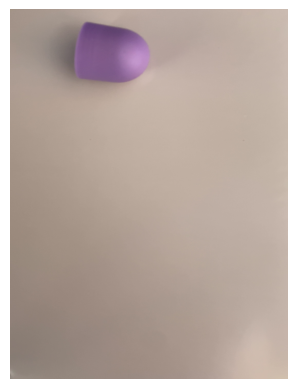

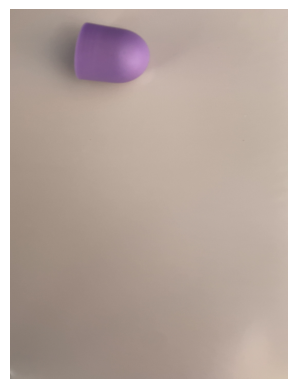

In [7]:
import matplotlib.pyplot as plt
video = cv2.VideoCapture("Video.mp4")
while True:
        ret, frame = video.read()  
        if not ret:
            break  
        
        frame = cv2.resize(frame, (600, 800))
        
        #cv2.imshow("Frame", frame)  # Afficher la frame
        #if cv2.waitKey(50) & 0xFF == ord('q'):
        #    break  
        
        plt.imshow(frame, cmap='gray')
        plt.axis('off')
        plt.show()
        
video.release()
#cv2.destroyAllWindows()

## Segmentation spatiale: Conversion et seuillage

### Conversion des frames en niveaux de gris et les sauvegarder

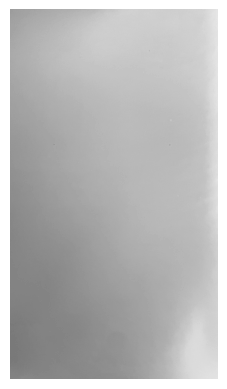

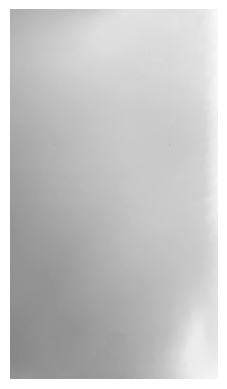

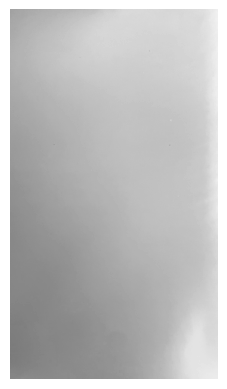

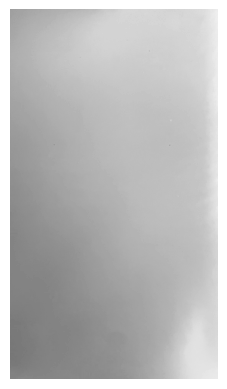

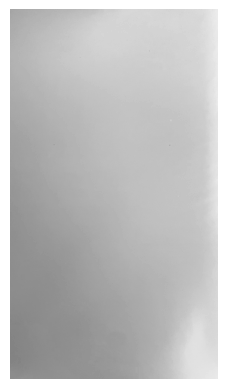

...

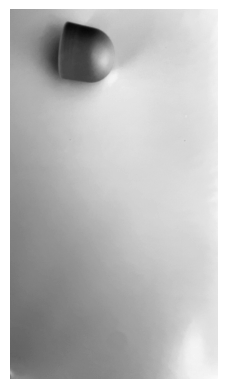

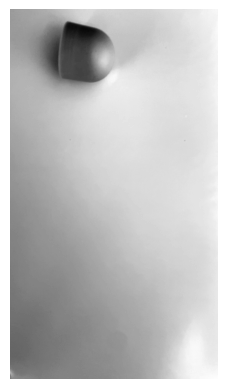

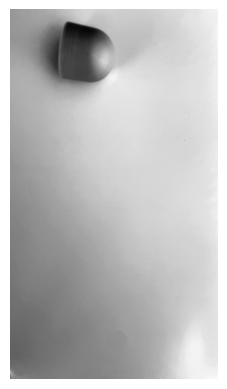

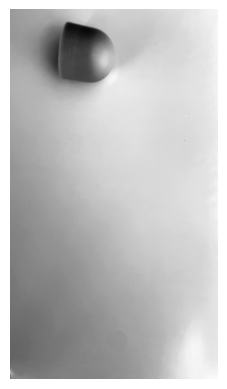

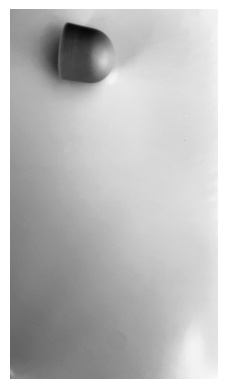

In [20]:
# Vérifier si la vidéo a pu être ouverte
video = cv2.VideoCapture("Video.mp4")

if not os.path.exists("frames_grey"):
    os.mkdir("frames_grey")

frame_number = 0  

while True:
    ret, frame = video.read()  
    if not ret:
        break  

    frame_grey = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
                  
    frame_filename = os.path.join("frames_grey", f"frame_{frame_number}.jpg")
    cv2.imwrite(frame_filename, frame_grey)
    
    plt.imshow(frame_grey, cmap='gray')
    plt.axis('off')
    plt.show()

    frame_number += 1

video.release()
cv2.destroyAllWindows()

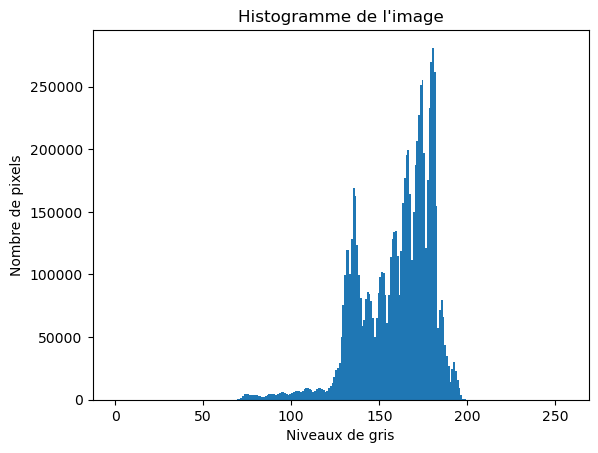

In [27]:
import numpy as np
import matplotlib.pyplot as plt

# Charger l'image
image = cv2.imread('frames_grey/frame_0120.jpg', 0)  # Chargez l'image en niveaux de gris (0)

# Calculez l'histogramme
hist = cv2.calcHist([image], [0], None, [256], [0, 256])

# Tracer l'histogramme
plt.hist(image.ravel(), 256, [0, 256])

# Paramètres du graphique
plt.xlabel('Niveaux de gris')
plt.ylabel('Nombre de pixels')
plt.title('Histogramme de l\'image')

plt.show()

=< Nous avons eu recours à l'histogramme pour savoir le seuil minimal pour la méthode de segmentation d'OTSU. Nous avons déduis pour q'on voit l'objet correctement, il vaut mieux le prendre queque soit la valeur supérieur à 100.

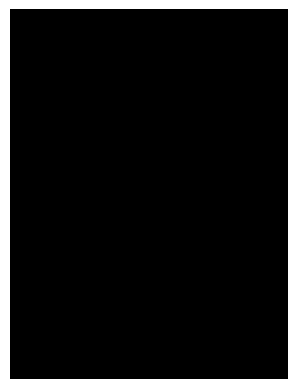

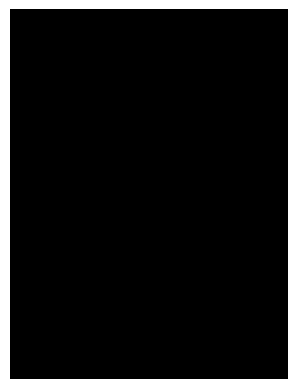

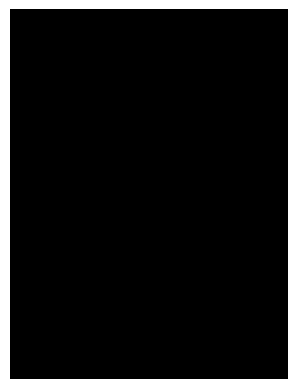

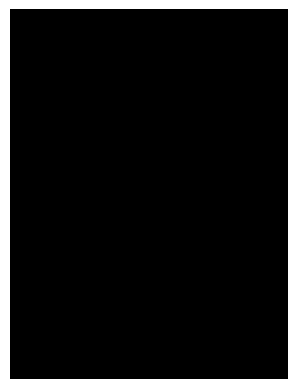

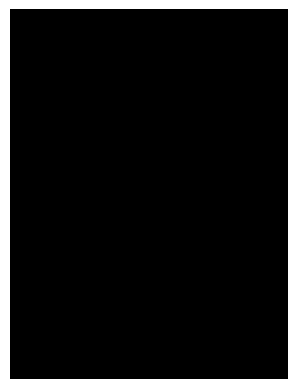

...

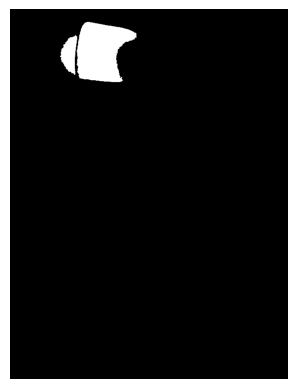

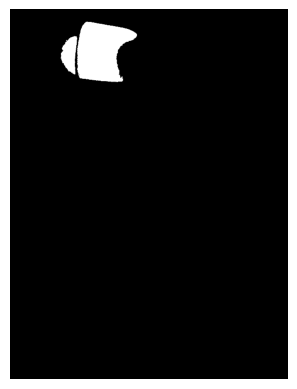

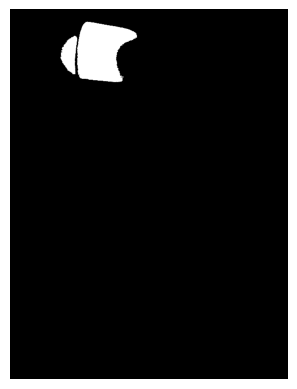

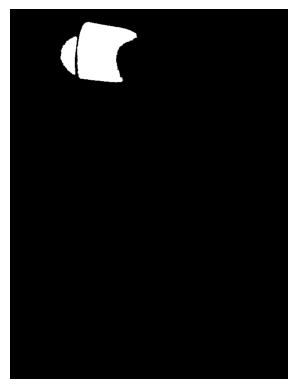

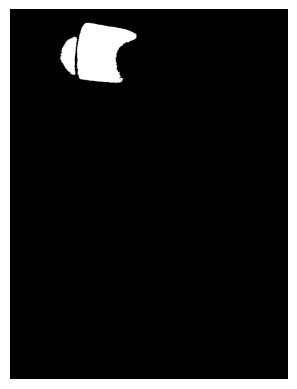

In [21]:
video = cv2.VideoCapture("Video.mp4")

while True:
    ret, frame = video.read()
    if not ret:
        break

    # Convertir le frame en niveaux de gris
    frame_grey = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # Appliquer la méthode binaire pour la segmentation
    _, segmented_frame = cv2.threshold(frame_grey, 115, 255, cv2.THRESH_BINARY )
    
    #Appliquer une fermeture morphologique (dilatation suivie de l'érosion) pour réduire le bruit
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (5, 5))    
    segmented_frame = cv2.dilate(segmented_frame, kernel, iterations=1)
    segmented_frame = cv2.erode(segmented_frame, kernel, iterations=2)
    
    #Inversion des niveux de gris 
    inv_segmented_frame = cv2.bitwise_not(segmented_frame)
    
    inv_segmented_frame = cv2.resize(inv_segmented_frame, (600, 800))
    frame = cv2.resize(frame, (600, 800))
        
    cv2.imshow("seg_Frame", inv_segmented_frame)  # une fenetre pour la video après segmentation
    cv2.imshow("frame_orig", frame) # une fenetre pour la video originale
    if cv2.waitKey(50) & 0xFF == ord('q'):
        break
    
    plt.imshow(inv_segmented_frame, cmap='gray')
    plt.axis('off')
    plt.show()

video.release()
cv2.destroyAllWindows()

Après avoir fait la segmentation, nous avons déduis qu'il y a quelques bruit et la morphologie de l'objet n'est pas précise d'ou nous avons appliqué une fermeture morphologique qui est une dilatation suivie d'une érosion.  

## Segmentation Temporelle

### implantation de la méthode de soustraction de l’image t-1 

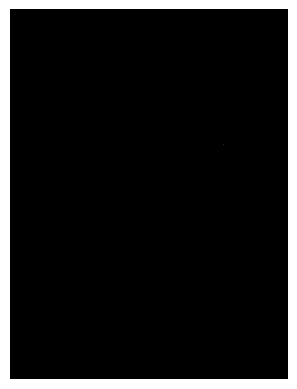

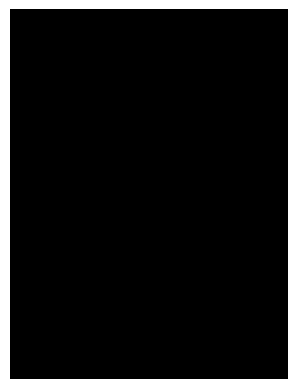

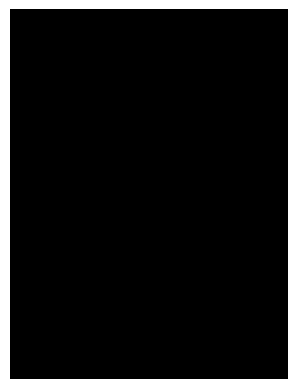

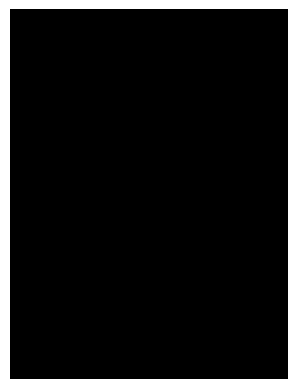

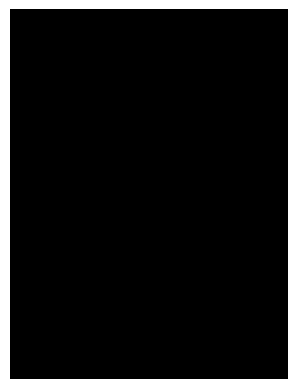

...

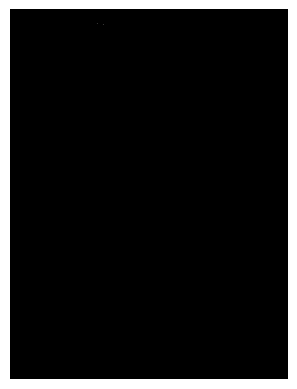

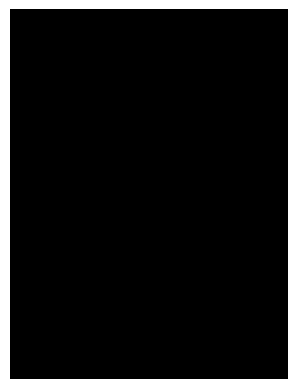

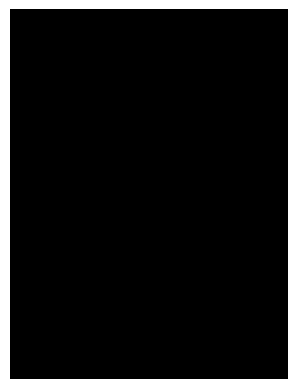

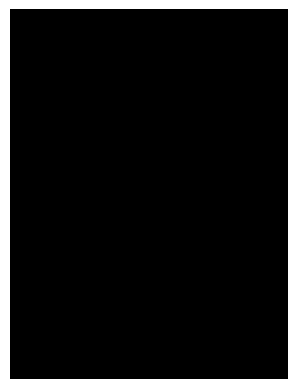

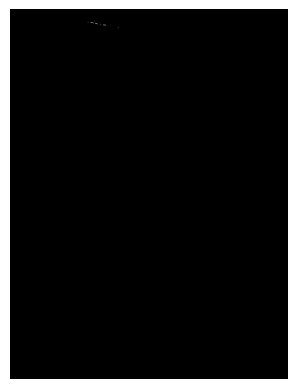

In [22]:
video = cv2.VideoCapture("Video.mp4")

ret, background = video.read()
if not ret:
    exit(1)

background_grey =  cv2.cvtColor(background, cv2.COLOR_BGR2GRAY)

while True:
    ret, frame = video.read()
    if not ret:
        break

    # Convertir le frame en niveaux de gris
    frame_grey = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    
    #différence de pixels
    diff = cv2.absdiff(frame_grey, background_grey)
    
    diff = cv2.resize(diff, (600, 800))
    frame = cv2.resize(frame, (600, 800))
    
    _, img_diff = cv2.threshold(diff, 30, 255, cv2.THRESH_BINARY)    
    #Appliquer une fermeture morphologique
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (5, 5))
    segmented_img_diff = cv2.morphologyEx(img_diff, cv2.MORPH_CLOSE, kernel)
        
    cv2.imshow("img_de_fond", segmented_img_diff)  # Afficher l'image de fond
    cv2.imshow("frame_orig", frame)
    
    # Mettre à jour l'image précédente
    background_grey = frame_grey
    
    if cv2.waitKey(50) & 0xFF == ord('q'):
        break
    
    plt.imshow(segmented_img_diff, cmap='gray')
    plt.axis('off')
    plt.show()

video.release()
cv2.destroyAllWindows()

### implantation de la méthode de différenciation de 3 frames 

In [23]:
def preprocess(frame):
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    _, frame = cv2.threshold(frame, 115, 255, cv2.THRESH_BINARY)
    frame = cv2.bitwise_not(frame)
    return frame

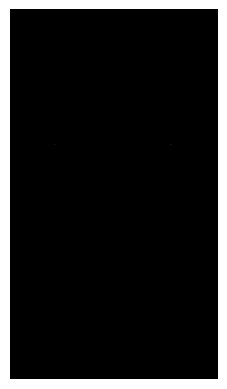

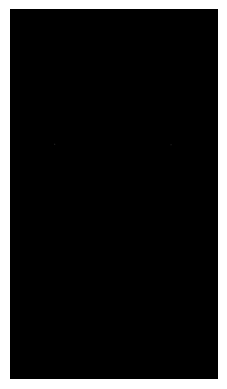

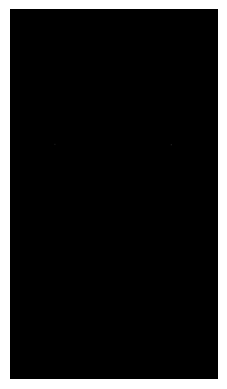

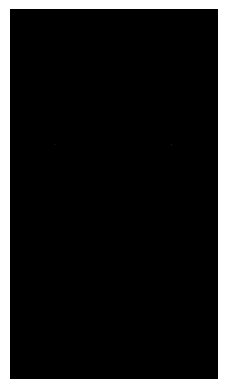

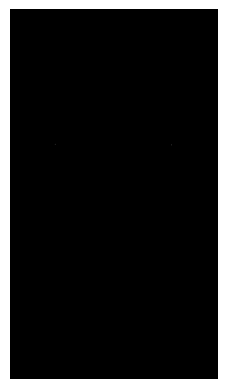

...

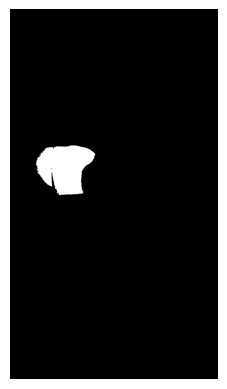

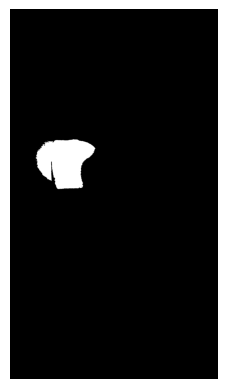

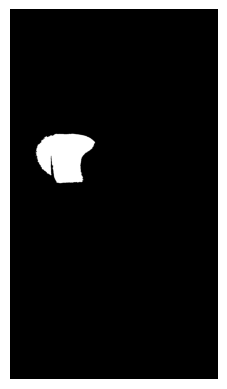

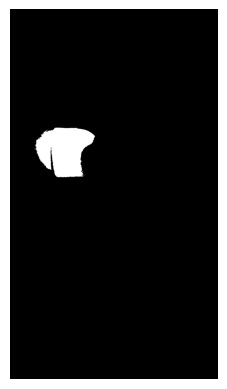

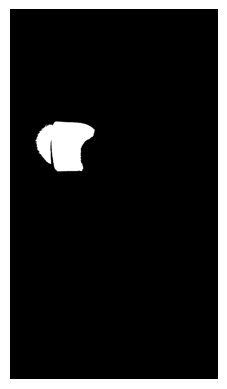

In [25]:
import numpy as np
import matplotlib.pyplot as plt
frames=frame_count

N=30
for i in range(N+1,frame_count-N-1):
    
    frame= np.array(Image.open(f'frames/frame_{i:04d}.jpg'))
    frame_pre=preprocess(frame) 
    
    prevframe= np.array(Image.open(f'frames/frame_{i-N:04d}.jpg'))
    prevframe_pre=preprocess(prevframe) 
    
    postframe= np.array(Image.open(f'frames/frame_{i+N:04d}.jpg'))
    postframe_pre=preprocess(postframe) 
    
    diff_previous = np.abs(prevframe_pre - frame_pre)
    _, diff_previous = cv2.threshold(diff_previous, 0, 255, cv2.THRESH_BINARY)
    
    diff_future = np.abs(postframe_pre - frame_pre)
    _, diff_future = cv2.threshold(diff_future, 0, 255, cv2.THRESH_BINARY)

    res = np.bitwise_and(diff_future, diff_previous)
        
    #Appliquer une fermeture morphologique
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (5, 5))
    segmented_res = cv2.morphologyEx(res, cv2.MORPH_CLOSE, kernel)
    
    plt.imshow(segmented_res, cmap='gray')
    plt.axis('off')
    plt.show()

### Implantation de la méthode « Adaptive Background Substruction »

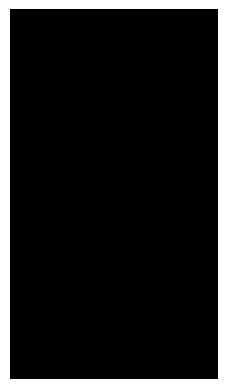

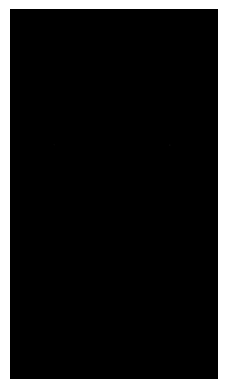

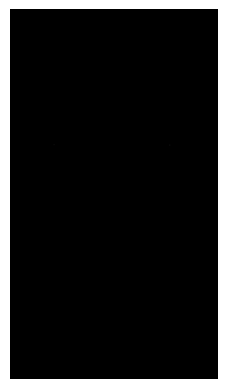

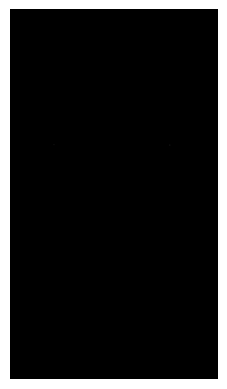

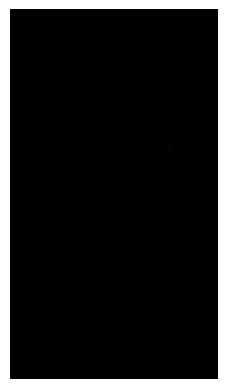

...

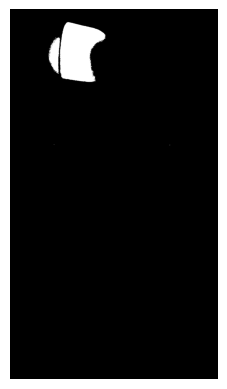

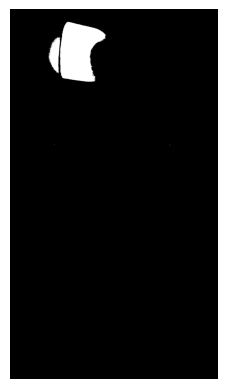

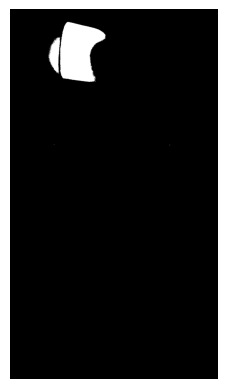

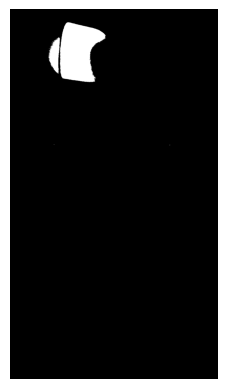

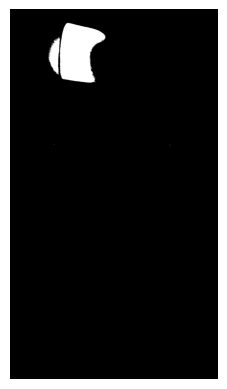

In [5]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
a=0.8

background = np.array(Image.open(f'frames/frame_0001.jpg'))
background = cv2.convertScaleAbs(background)

for i in range(2,frame_count) :
    frame= np.array(Image.open(f'frames/frame_{i:04d}.jpg'))
    frame_pre=preprocess(frame) 
    
    background_pre = preprocess(background)
    
    diff = np.abs(background_pre - frame_pre)
    _, diff_seg = cv2.threshold(diff, 0, 255, cv2.THRESH_BINARY)
    
    background_pre = a * frame_pre + (1-a) * background_pre
    
    #Appliquer une fermeture morphologique
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (5, 5))
    seg_res = cv2.morphologyEx(diff_seg, cv2.MORPH_CLOSE, kernel)
    
    diffs = cv2.resize(seg_res, (600, 800))
    frames = cv2.resize(frame, (600,800))
    
    cv2.imshow("diffs", diffs)
    cv2.imshow("origine", frames)
    if cv2.waitKey(25) & 0xFF == ord('q'):
        break
    
    plt.imshow(diffs, cmap='gray')
    plt.axis('off')
    plt.show()

### Méthodes d’estimation et soustraction de fond 

#### BackgroundSubtractorMOG2 
Il s’agit  d’un algorithme de segmentation d’arrière-plan / premier plan basé sur un mélange gaussien. Il offre une meilleure adaptabilité aux scènes variables en raison des changements d’éclairage, etc.

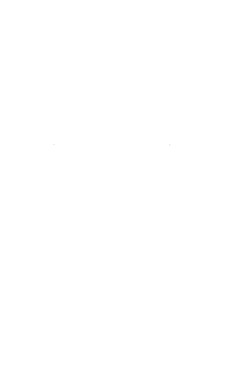

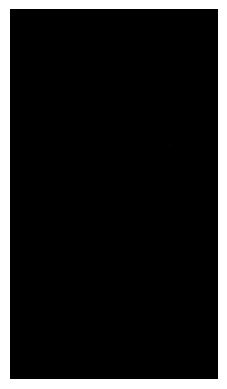

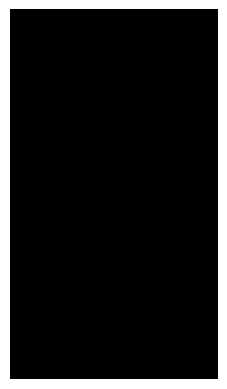

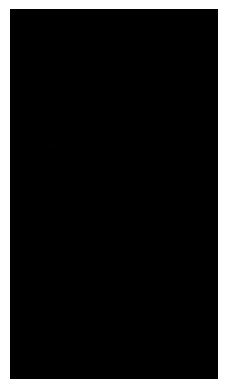

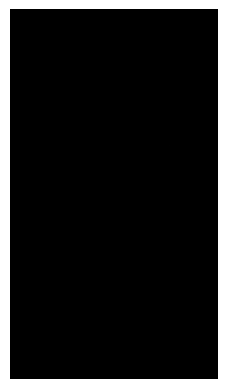

...

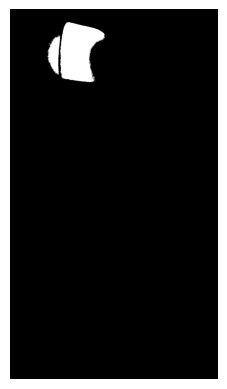

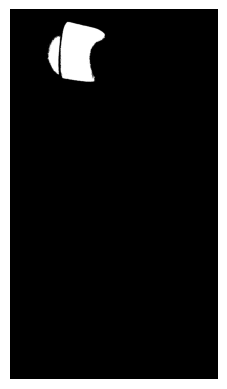

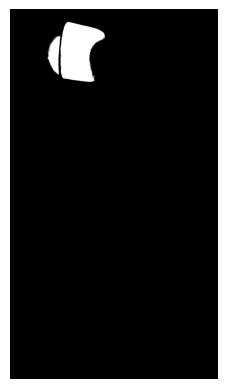

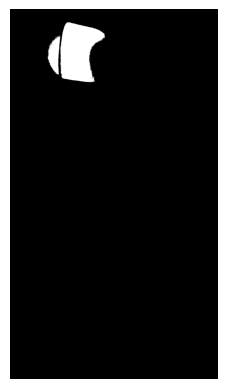

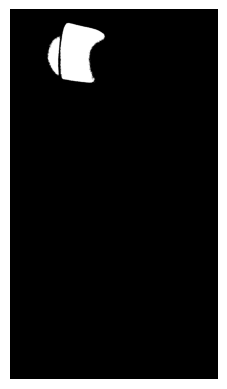

In [3]:
import matplotlib.pyplot as plt
import cv2

MOG = cv2.createBackgroundSubtractorMOG2()

video = cv2.VideoCapture("Video.mp4")

while True:
    ret, frame = video.read()

    if not ret:
        break
    frame_pre = preprocess(frame)
    
    # Soustrayez l'arrière-plan de la trame
    frame_sub = MOG.apply(frame_pre)
    
    #Appliquer une fermeture morphologique
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (5, 5))
    segmented_frame_sub = cv2.morphologyEx(frame_sub, cv2.MORPH_CLOSE, kernel)
    
    plt.imshow(frame_sub, cmap='gray')
    plt.axis('off')
    plt.show()

#### La méthode BackgroundSubtractor K-Nearest Neighbors (KNN): 
Elle soustrait l'arrière-plan des images en utilisant une approche basée sur la classification des pixels en tant qu'arrière-plan ou avant-plan en se basant sur les K pixels les plus proches dans le temps.

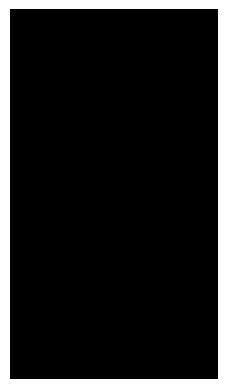

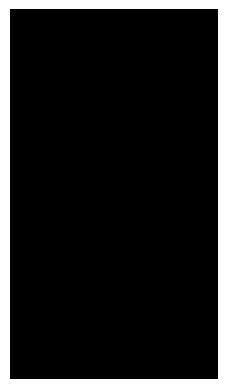

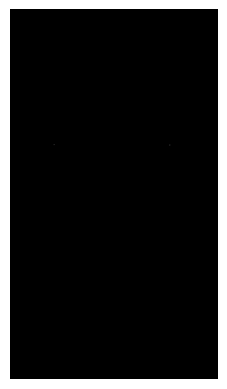

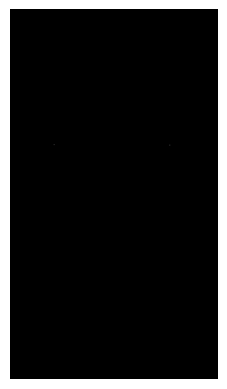

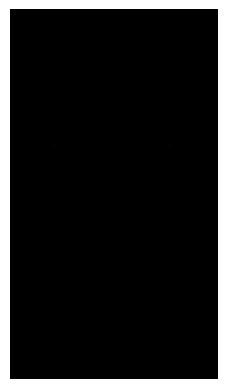

...

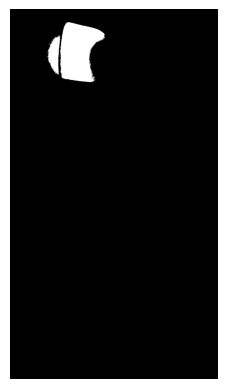

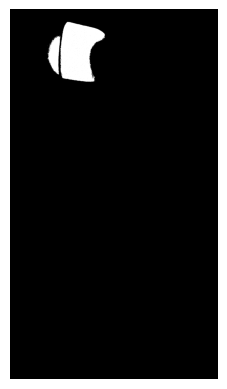

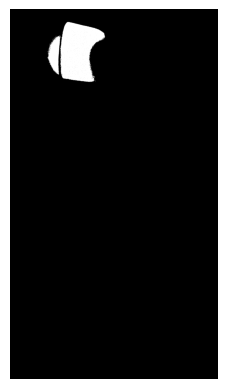

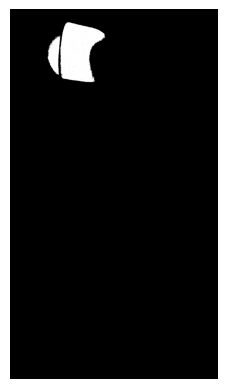

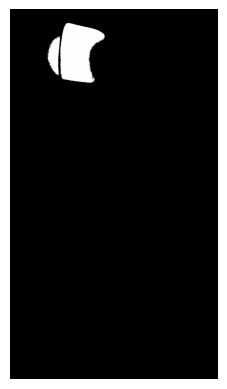

In [4]:
import matplotlib.pyplot as plt
import cv2

KNN = cv2.createBackgroundSubtractorKNN()

video = cv2.VideoCapture("Video.mp4")

while True:
    ret, frame = video.read()

    if not ret:
        break
    frame_pre = preprocess(frame)
    
    # Soustrayez l'arrière-plan de la trame
    frame_sub_KNN = KNN.apply(frame_pre)
    
    plt.imshow(frame_sub_KNN, cmap='gray')
    plt.axis('off')
    plt.show()